# AAI-500_Online_Retail_Data_Analysis

Names: Arifa Kokab, Andrew Roehr, Laxmi Sulakshana Rapolu 


Packages

In [56]:
from ucimlrepo import fetch_ucirepo 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

EDA exploratory_data_analysis

Quantity - missing values
0
UnitPrice - missing values
0
Index(['Description', 'Quantity', 'InvoiceDate', 'UnitPrice', 'CustomerID',
       'Country'],
      dtype='object')
                           Description  Quantity         InvoiceDate  \
0   WHITE HANGING HEART T-LIGHT HOLDER         6 2010-12-01 08:26:00   
1                  WHITE METAL LANTERN         6 2010-12-01 08:26:00   
2       CREAM CUPID HEARTS COAT HANGER         8 2010-12-01 08:26:00   
3  KNITTED UNION FLAG HOT WATER BOTTLE         6 2010-12-01 08:26:00   
4       RED WOOLLY HOTTIE WHITE HEART.         6 2010-12-01 08:26:00   

   UnitPrice CustomerID         Country  Total  
0       2.55    17850.0  United Kingdom  15.30  
1       3.39    17850.0  United Kingdom  20.34  
2       2.75    17850.0  United Kingdom  22.00  
3       3.39    17850.0  United Kingdom  20.34  
4       3.39    17850.0  United Kingdom  20.34  
All Data Types
Description          category
Quantity                int64
InvoiceDate    datetime6

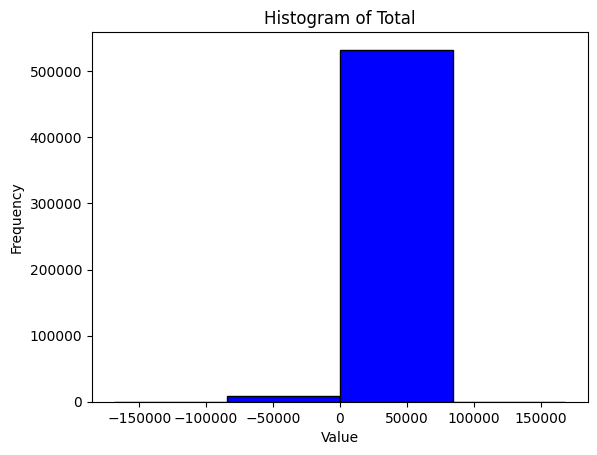

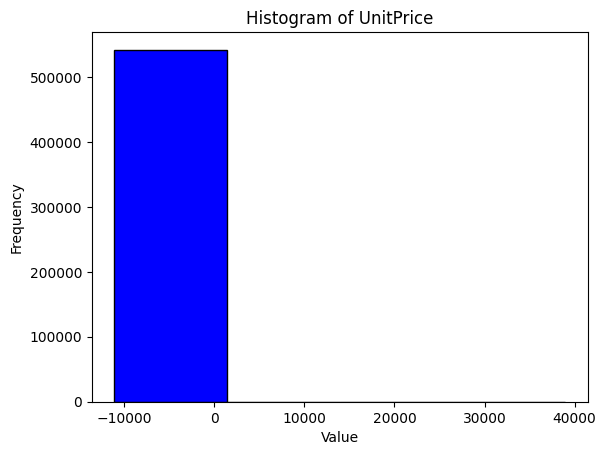

Customer Analysis
            purchase_count  total_spending
CustomerID                                
14646.0               2085       279489.02
18102.0                433       256438.49
17450.0                351       187482.17
14911.0               5903       132572.62
12415.0                778       123725.45
Country Analysis


/var/folders/zm/ljxd_tvn6xgb8l3zfbrtq2k80000gn/T/ipykernel_26003/3063128317.py:72: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/var/folders/zm/ljxd_tvn6xgb8l3zfbrtq2k80000gn/T/ipykernel_26003/3063128317.py:78: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



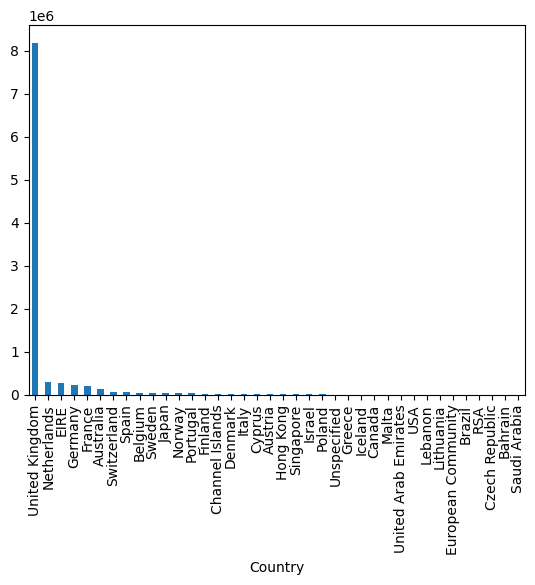

In [57]:
# fetch dataset 
online_retail = fetch_ucirepo(id=352) 
  
# data (as pandas dataframes) 
X = online_retail.data.features 
y = online_retail.data.targets

# variable information 
#print(online_retail.variables) 
A = X["Quantity"].isnull().sum()
print('Quantity - missing values')
print(A)
B = X["UnitPrice"].isnull().sum()
print('UnitPrice - missing values')
print(B)

#Removing missing data rows
df_filtered = X[X['Quantity'].notnull()].copy()
df_filtered2 = df_filtered[df_filtered['UnitPrice'].notnull()].copy()
print(df_filtered2.columns)

#Assigning Data Type to each variable
df_filtered2['Quantity'] = df_filtered2['Quantity'].astype(int)
df_filtered2['UnitPrice'] = df_filtered2['UnitPrice'].astype(float)
df_filtered2['CustomerID'] = df_filtered2['CustomerID'].astype('category')
df_filtered2['Description'] = df_filtered2['Description'].astype('category')
df_filtered2['Country'] = df_filtered2['Country'].astype('category')
df_filtered2['InvoiceDate'] = pd.to_datetime(df_filtered2['InvoiceDate'])

#Adding a new column to find the Total (Qty x Unit Price)
df_filtered2["Total"] = df_filtered2["Quantity"] * df_filtered2["UnitPrice"]

###############################################################################################

#Overview of all filtered data***(I am struggling to add StockCode columns to this dataframe)
print(df_filtered2.head())
print('All Data Types')
print(df_filtered2.dtypes)
print('Data Information')
print(df_filtered2.info())

#Summary Statistics of Numerical Columns
print('Total Value - Summary Statistics')
print(df_filtered2["Total"].describe())
print("Quantity - Summary Statistics")
print(df_filtered2['Quantity'].describe())
print('Unit Price - Summary Statistics')
print(df_filtered2['UnitPrice'].describe())

#Count for Categorical Columns
print('Count of Unique Values for Categorical Columns')
print(df_filtered2[['Country', 'CustomerID', 'Description']].nunique())

###############################################################################################

#EXPLORATORY DATA ANALYSIS: (I am struggling with some of them, please see below)
#Histogram of Total
plt.hist(df_filtered2['Total'], bins=4, color='blue', edgecolor='black')
plt.title('Histogram of Total')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.show()
###############################################################################################
#Histogram of Unit Price
plt.hist(df_filtered2['UnitPrice'], bins=4, color='blue', edgecolor='black')
plt.title('Histogram of UnitPrice')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.show()
###############################################################################################
#Customer Analysis
customer_info = df_filtered2.groupby('CustomerID').agg({'Total':['count','sum']})
customer_info.columns = ['purchase_count','total_spending']
print('Customer Analysis')
print(customer_info.sort_values(by='total_spending',ascending=False).head())
###############################################################################################
#Country Analysis
country_sales = df_filtered2.groupby('Country')['Total'].sum().sort_values(ascending=False)
country_sales.plot(kind='bar')
print('Country Analysis')
plt.show()
###############################################################################################
#Interactive Plots
fig = px.scatter(df_filtered2, x='Quantity', y='Total', color='Country')
fig.show()
fig = px.scatter(df_filtered2, x='Quantity', y='Total', color='CustomerID')
fig.show()

## Staging Variables for Model Selection & Analysis

In [58]:
X = df_filtered2[['Quantity', 'UnitPrice']]  # Predictor variables
y = df_filtered2['Total']  # Target variable

# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

## Linear Regression Model Initialization
The Linear Regression model was selected for its straightforward interpretability and the anticipated direct correlation between the input features and the target variable, which aligns well with typical patterns observed in retail sales data.

In [59]:
# Initializing and fitting the Linear Regression model
model_lr = LinearRegression()
model_lr.fit(X_train, y_train)

predictions = model_lr.predict(X_test)

## Linear Regression Model Analysis

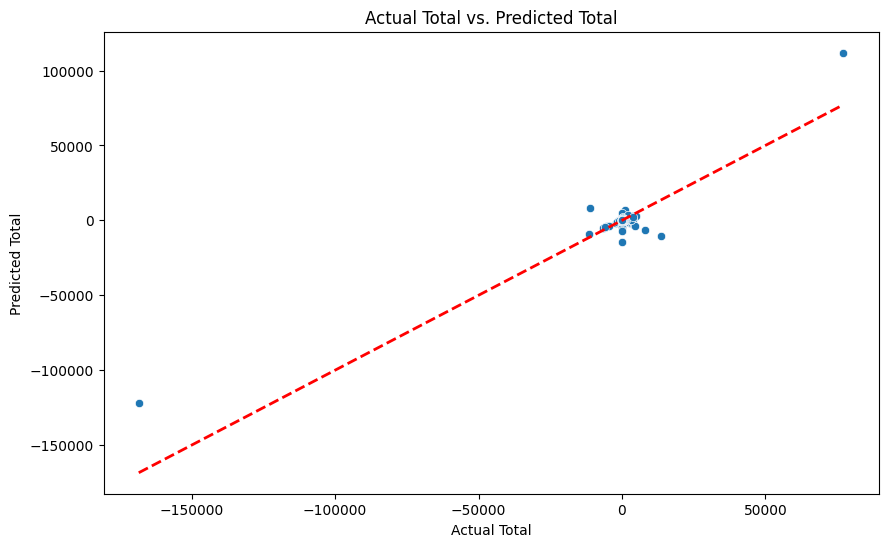

Mean Absolute Error (MAE): 17.43
Mean Squared Error (MSE): 50446.16
Root Mean Squared Error (RMSE): 224.60
R-squared Score: 0.85


In [60]:
# Actual vs Predicted scatter plot for Linear Regression
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=predictions)
plt.title('Actual Total vs. Predicted Total')
plt.xlabel('Actual Total')
plt.ylabel('Predicted Total')
# Drawing a line for perfect predictions
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, linestyle='--')
plt.show()

# Calculating performance metrics
mae = mean_absolute_error(y_test, predictions)
mse = mean_squared_error(y_test, predictions)
rmse = np.sqrt(mse) # Root Mean Squared Error
r2 = r2_score(y_test, predictions)

print(f"Mean Absolute Error (MAE): {mae:.2f}")
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"Root Mean Squared Error (RMSE): {rmse:.2f}")
print(f"R-squared Score: {r2:.2f}")

### Linear Regression Model Analysis Interpretation
The Linear Regression model demonstrates a strong ability to predict the total sales with an R-squared score of 0.85, indicating that 85% of the variance in the total sales is explained by the model. However, the presence of a relatively high Root Mean Squared Error (RMSE) of 224.60 suggests that there are still significant discrepancies between the predicted and actual values for certain observations.

## Decision Tree Model Initialization
The Decision Tree model was selected to address the shortcomings of in the Linear Regression Model, particularly its struggle with complex, non-linear relationships and significant prediction errors, as highlighted by the high RMSE. Its hierarchical decision-making capability provides a nuanced understanding of the diverse factors influencing retail sales, effectively capturing the intricacies that a linear approach may overlook.

In [61]:
# Initializing and fitting the Decision Tree model
model_dt = DecisionTreeRegressor(random_state=42)
model_dt.fit(X_train, y_train)

predictions_dt = model_dt.predict(X_test)

## Decision Tree Model Analysis

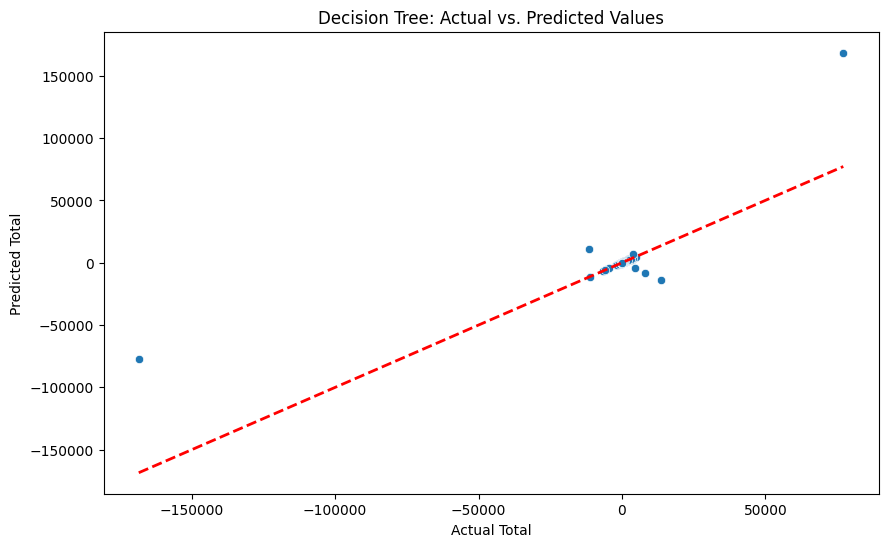

Decision Tree Mean Absolute Error (MAE): 2.59
Decision Tree Mean Squared Error (MSE): 168635.72
Decision Tree Root Mean Squared Error (RMSE): 410.65
Decision Tree R-squared Score: 0.49


In [62]:
# Actual vs Predicted scatter plot for Decision Tree
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=predictions_dt)
plt.title('Decision Tree: Actual vs. Predicted Values')
plt.xlabel('Actual Total')
plt.ylabel('Predicted Total')
# Drawing a line for perfect predictions
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, linestyle='--')
plt.show()

# Calculating performance metrics for Decision Tree
mae_dt = mean_absolute_error(y_test, predictions_dt)
mse_dt = mean_squared_error(y_test, predictions_dt)
rmse_dt = np.sqrt(mse_dt)  # Root Mean Squared Error
r2_dt = r2_score(y_test, predictions_dt)

print(f"Decision Tree Mean Absolute Error (MAE): {mae_dt:.2f}")
print(f"Decision Tree Mean Squared Error (MSE): {mse_dt:.2f}")
print(f"Decision Tree Root Mean Squared Error (RMSE): {rmse_dt:.2f}")
print(f"Decision Tree R-squared Score: {r2_dt:.2f}")


### Decision Tree Model Analysis Interpretation
The Decision Tree model, with an R-squared of 0.49, shows it's less effective at predicting sales, capturing less than half the variation compared to the Linear Regression. Its higher MSE and RMSE indicate that its predictions are generally more off target, suggesting it might not be the best fit for this data.

## Random Forest Model Intialization
The Random Forest model was seleceted to overcome the Decision Tree's limitations, as evidenced by its lower R-squared value and higher errors, which suggest a potential overfit to the training data. Random Forests aggregate multiple trees to improve prediction accuracy and generalization to unseen data, aiming to rectify the single Decision Tree's shortcomings.

In [63]:
# Initializing and fitting the Random Forest Model
model_rf = RandomForestRegressor(n_estimators=100, random_state=42)
model_rf.fit(X_train, y_train)

predictions_rf = model_rf.predict(X_test)

## Random Forest Model Analysis

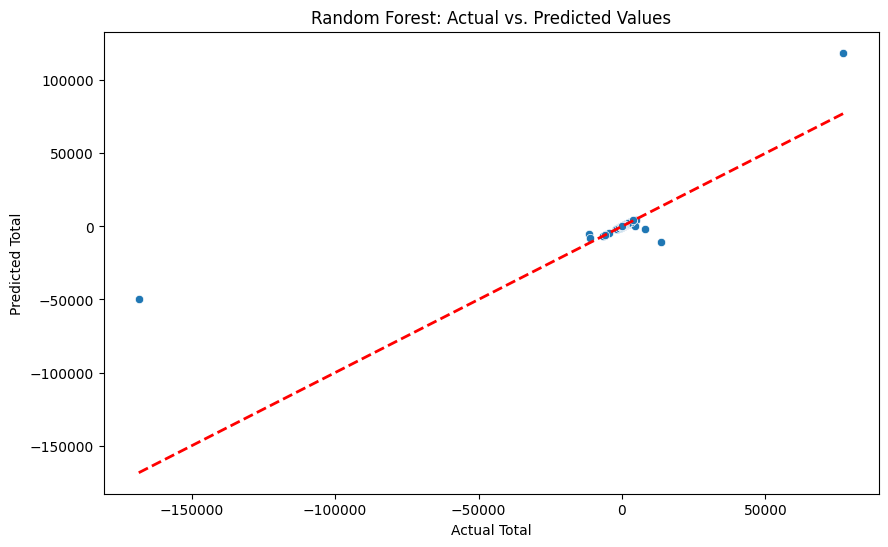

Random Forest Mean Absolute Error (MAE): 2.06
Random Forest Mean Squared Error (MSE): 153271.20
Random Forest Root Mean Squared Error (RMSE): 391.50
Random Forest R-squared Score: 0.53


In [64]:
# Actual vs Predicted scatter plot for Random Forest Model
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=predictions_rf)
plt.title('Random Forest: Actual vs. Predicted Values')
plt.xlabel('Actual Total')
plt.ylabel('Predicted Total')
# Drawing a line for perfect predictions
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, linestyle='--')
plt.show()

# Calculating performance metrics for Random Forest Model
mae_rf = mean_absolute_error(y_test, predictions_rf)
mse_rf = mean_squared_error(y_test, predictions_rf)
rmse_rf = np.sqrt(mse_rf)  # Root Mean Squared Error
r2_rf = r2_score(y_test, predictions_rf)

print(f"Random Forest Mean Absolute Error (MAE): {mae_rf:.2f}")
print(f"Random Forest Mean Squared Error (MSE): {mse_rf:.2f}")
print(f"Random Forest Root Mean Squared Error (RMSE): {rmse_rf:.2f}")
print(f"Random Forest R-squared Score: {r2_rf:.2f}")

### Random Forest Model Analysis Interpretation
The Random Forest model shows a modest improvement over the Decision Tree with an R-squared score of 0.53, indicating it can predict a slightly higher proportion of the variance in total sales. However, the still considerable RMSE of 391.50 points to persistent prediction errors, suggesting further model tuning or alternative approaches may be necessary for optimal performance.

## Fine Tuning Random Forest Model & Analysis 
The Random Forest Model was selected for fine tuning (i.e. rerunning without outliers) since it had the lowest errors and it's r-squared value most likely suffered due to the major outliers existing on the opposite side of the spectrum.

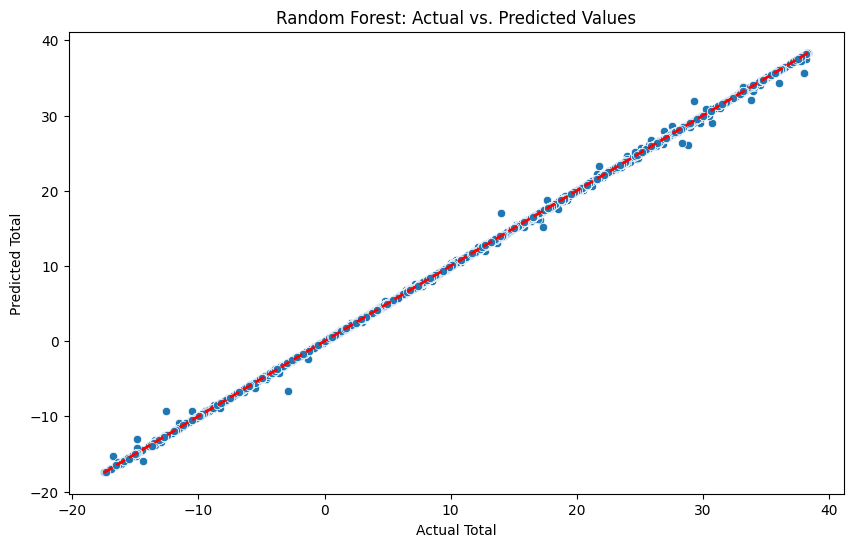

Random Forest Mean Absolute Error (MAE): 0.00
Random Forest Mean Squared Error (MSE): 0.00
Random Forest Root Mean Squared Error (RMSE): 0.03
Random Forest R-squared Score: 1.00


In [65]:
# Calculating IQR for 'Total'
Q1 = df_filtered2['Total'].quantile(0.25)
Q3 = df_filtered2['Total'].quantile(0.75)
IQR = Q3 - Q1

# Defining bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filtering out outliers
df_no_outliers = df_filtered2[(df_filtered2['Total'] >= lower_bound) & (df_filtered2['Total'] <= upper_bound)]

# Restaging
X_no_outliers = df_no_outliers[['Quantity', 'UnitPrice']] # Predictor variables w/o outliers
y_no_outliers = df_no_outliers['Total'] # Target variable w/o outliers

# Splitting the data into training and testing sets without outliers
X_train, X_test, y_train, y_test = train_test_split(X_no_outliers, y_no_outliers, test_size=0.2, random_state=42)

# Initializing and fitting the Random Forest Model
model_rf = RandomForestRegressor(n_estimators=100, random_state=42)
model_rf.fit(X_train, y_train)

predictions_rf = model_rf.predict(X_test)

# Actual vs Predicted scatter plot for Random Forest Model
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_test, y=predictions_rf)
plt.title('Random Forest: Actual vs. Predicted Values')
plt.xlabel('Actual Total')
plt.ylabel('Predicted Total')
# Drawing a line for perfect predictions
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', lw=2, linestyle='--')
plt.show()

# Calculating performance metrics for Random Forest Model
mae_rf = mean_absolute_error(y_test, predictions_rf)
mse_rf = mean_squared_error(y_test, predictions_rf)
rmse_rf = np.sqrt(mse_rf)  # Root Mean Squared Error
r2_rf = r2_score(y_test, predictions_rf)

print(f"Random Forest Mean Absolute Error (MAE): {mae_rf:.2f}")
print(f"Random Forest Mean Squared Error (MSE): {mse_rf:.2f}")
print(f"Random Forest Root Mean Squared Error (RMSE): {rmse_rf:.2f}")
print(f"Random Forest R-squared Score: {r2_rf:.2f}")

### Random Forest Model Analysis Without Outliers Interpretation
The Random Forest model achieved an R-squared score of 1.00 and an RMSE of 0.03, which is a near perfect predictions on the test data. A bit too perfect, which could be a result of overfitting but seeing how only two outliers on the opposite ends of the spectrum was removed, it is most likely due the lack of diversity or the homogeneity of the data set.